In [1]:
%load_ext autoreload
%autoreload 2
import bento
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from tqdm.auto import tqdm
from shapely.geometry import MultiPolygon

figdir = "/home/ckmah/d/bento-manuscript/figures"

In [2]:
sc.set_figure_params(dpi=100, dpi_save=300)

In [3]:
bento.ds.get_dataset_info()

,n_cells,n_genes,n_points,url,description
name,,,,,
merfish,1153.0,135.0,16907948.0,https://ndownloader.figshare.com/files/29046861,U2-OS cell line profiled with MERFISH
merfish_processed,1022.0,135.0,15315044.0,https://figshare.com/ndownloader/files/35596979,precomputed version of the U2-OS cell line pro...
seqfish,211.0,9506.0,5306521.0,https://ndownloader.figshare.com/files/29046873,3T3 cell line profiled with seqFISH+
seqfish_processed,179.0,3726.0,4680210.0,https://figshare.com/ndownloader/files/35596982,precomputed version of the 3T3 cell line profi...
cardio_control1,NaN,NaN,NaN,https://figshare.com/ndownloader/files/39850386,"vehicle replicate 1, iPSC-derived cardiomyocyt..."
cardio_control2,NaN,NaN,NaN,https://figshare.com/ndownloader/files/39850383,"vehicle replicate 2, iPSC-derived cardiomyocyt..."
cardio_dox1,NaN,NaN,NaN,https://figshare.com/ndownloader/files/39850470,"treatment replicate 1, doxorubicin-treated iPS..."
cardio_dox2,NaN,NaN,NaN,https://figshare.com/ndownloader/files/39850613,"treatment replicate 2, doxorubicin-treated iPS..."


In [4]:
adatas = []
for p in tqdm(["cardio_control1", "cardio_control2", "cardio_dox1", "cardio_dox2"]):
    adata = bento.ds.load_dataset(p)
    adatas.append(adata)

adata_all = bento.io.concatenate(adatas)

  0%|          | 0/4 [00:00<?, ?it/s]

In [5]:
adata_all.obs["batch"] = (
    adata_all.obs["batch"]
    .astype(str)
    .map(
        {
            "0": "vehicle1",
            "1": "vehicle2",
            "2": "treatment1",
            "3": "treatment2",
        }
    )
)
adata_all.uns["points"]["batch"] = (
    adata_all.uns["points"]["batch"]
    .astype(str)
    .map(
        {
            "0": "vehicle1",
            "1": "vehicle2",
            "2": "treatment1",
            "3": "treatment2",
        }
    )
)

In [6]:
adata_sc = bento.ut.sc_format(adata_all, copy=True)

In [7]:
sc.pp.normalize_total(adata_sc)
sc.pp.log1p(adata_sc)
sc.pp.pca(adata_sc)
sc.pp.neighbors(adata_sc)
sc.tl.umap(adata_sc)

In [8]:
sc.tl.leiden(adata_sc, resolution=0.5)

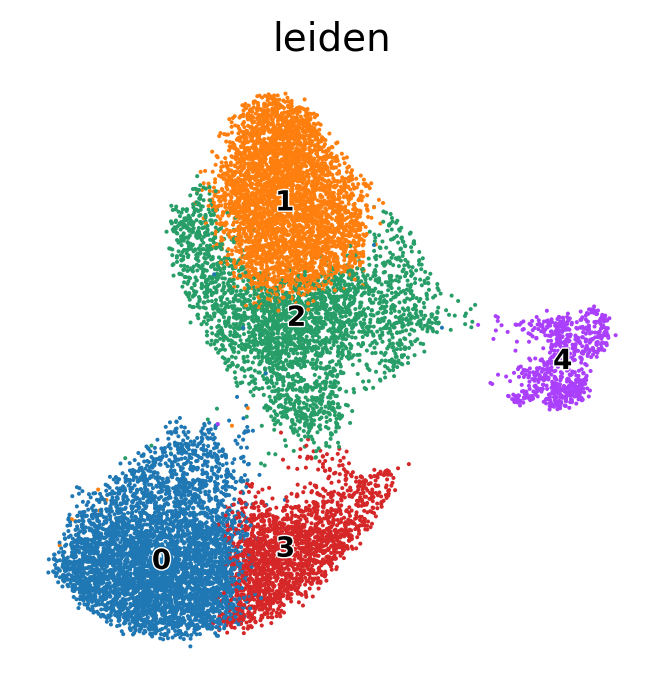

In [166]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.umap(
        adata_sc,
        color="leiden",
        legend_loc="on data",
        legend_fontsize=10,
        legend_fontoutline=1,
        frameon=False,
        save="cardio_leiden.svg",
    )

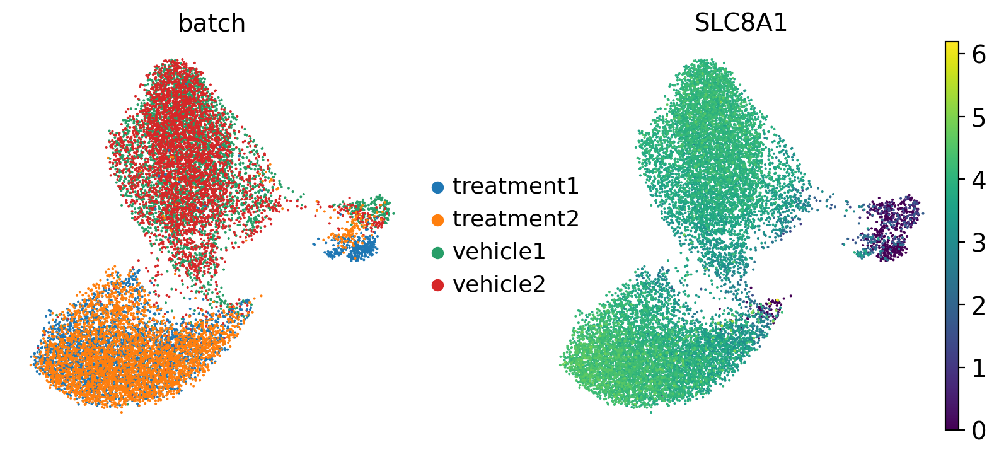

In [167]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.umap(
        adata_sc,
        color=["batch", "SLC8A1"],
        frameon=False,
        save="cardio.svg",
    )

Subset `adata_all` for bento

In [10]:
adata_all = adata_all[adata_sc.obs["leiden"] != "4"]
adata_all = adata_all[adata_all.obs["nucleus_shape"] != None]

bento.ut.sync(adata_all)

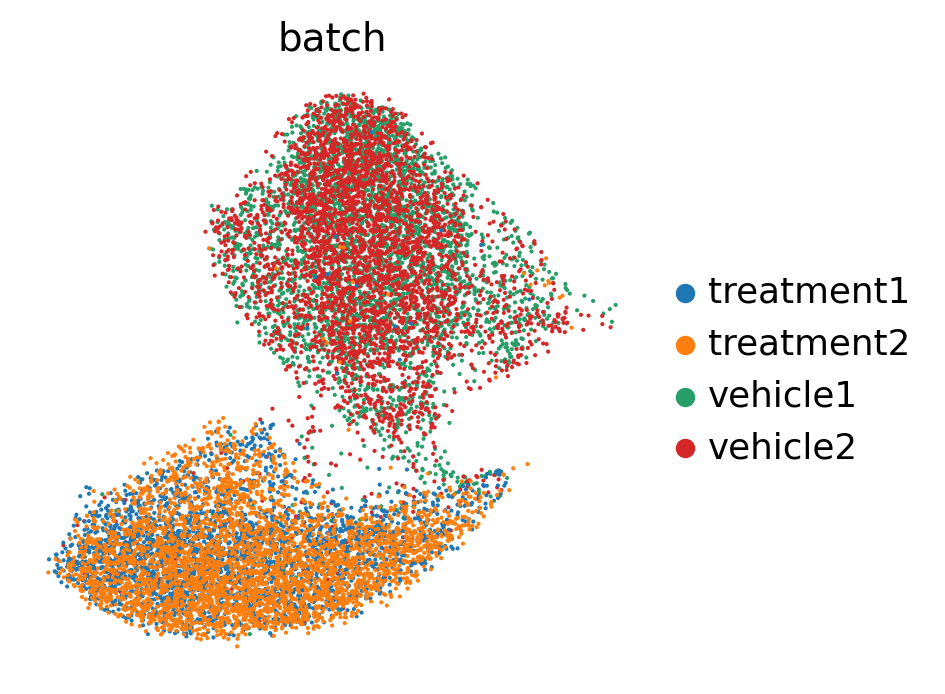

In [169]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.umap(
        adata_sc[adata_sc.obs["leiden"] != "4"],
        color="batch",
        frameon=False,
        save="cardio_batch_no4.svg",
    )

In [12]:
adata_diff = adata_sc[adata_sc.obs["leiden"] != "4"]
bento.ut.sc_format(adata_diff)

In [13]:
adata_diff.obs["batch"].value_counts()

vehicle1      3595
vehicle2      3564
treatment2    3495
treatment1    2765
Name: batch, dtype: int64

In [14]:
adata_diff.obs["batch"] = adata_diff.obs["batch"].apply(lambda s: s[:-1])

In [15]:
sc.tl.rank_genes_groups(adata_diff, "batch", method="wilcoxon", pts=True)

In [16]:
de = sc.get.rank_genes_groups_df(adata_diff, "treatment")
de["-log10_padj"] = -np.log10(de["pvals_adj"])
de["-log10_padj"] = de["-log10_padj"].clip(upper=150)
de_top = de.sort_values("-log10_padj").tail(20)

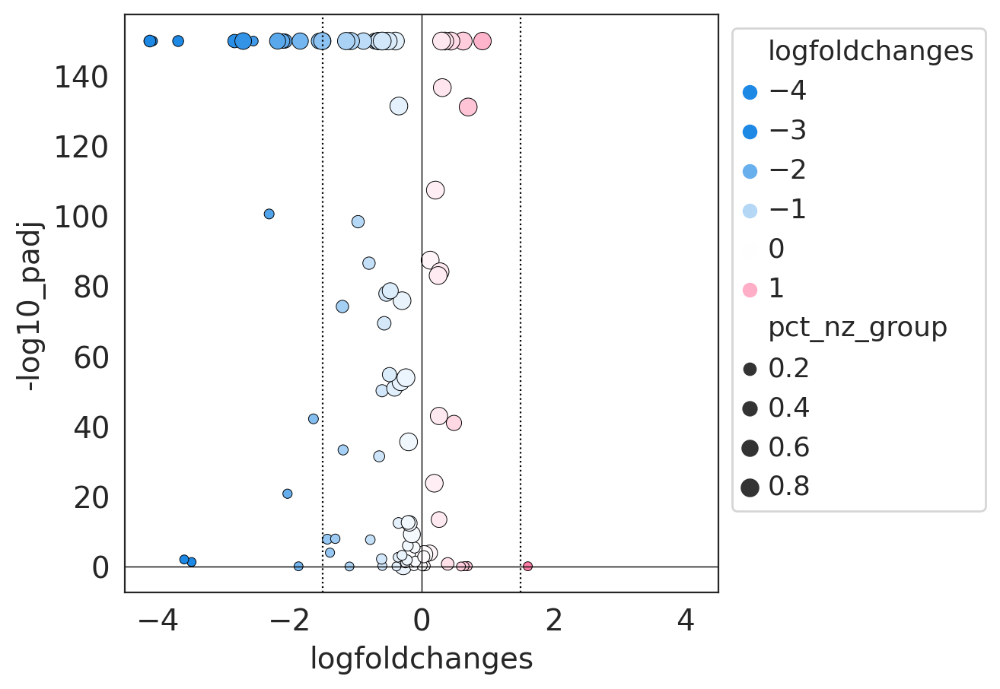

In [17]:
with sns.axes_style("white"):
    plt.figure(figsize=(5, 5))
    ax = sns.scatterplot(
        data=de,
        x="logfoldchanges",
        y="-log10_padj",
        hue="logfoldchanges",
        size="pct_nz_group",
        hue_norm=(-3, 3),
        palette=bento.colors.red2blue,
        edgecolor="black",
    )
    # ax.axhline(-np.log10(0.05), c="black", ls=":", lw)
    ax.axvline(0, c="black", lw=0.5)
    ax.axhline(0, c="black", lw=0.5)
    ax.axvline(-1.5, c="black", ls=":", lw=0.8)
    ax.axvline(1.5, c="black", ls=":", lw=0.8)
    ax.set_xlim(-4.5, 4.5)
    plt.legend(bbox_to_anchor=[1, 1])

    plt.savefig(f"{figdir}//cardio_12_de_volcano.svg", dpi=300)

In [18]:
sc.settings.figdir = figdir

[13:20:17] WARNING  findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.    ]8;id=272074;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py\font_manager.py]8;;\:]8;id=139645;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py#1346\1346]8;;\

           WARNING  findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.    ]8;id=572702;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py\font_manager.py]8;;\:]8;id=798142;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/font_manager.py#1346\1346]8;;\

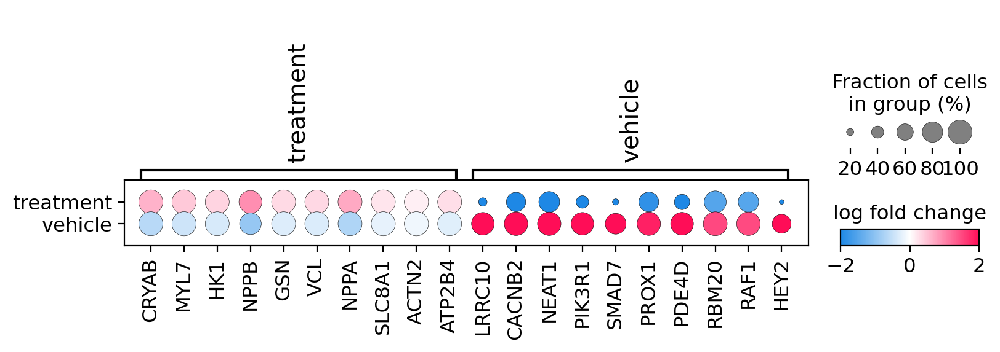

In [19]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.rank_genes_groups_dotplot(
        adata_diff,
        values_to_plot="logfoldchanges",
        cmap=bento.colors.red2blue,
        vmax=2,
        vmin=-2,
        save="cardio_12_de_dotplot.svg",
    )

In [21]:
batch_names = ["vehicle1", "treatment1"]
dx = 0.138

In [55]:
adatas = []
crop_bounds = [(2000, 5500), (6000, 9500)]
bento.ut.geo_format(adata_all)
for batch in tqdm(batch_names):
    adata = adata_all[adata_all.obs["batch"] == batch]
    bento.ut.sync(adata)
    adata = bento.geo.crop(adata, crop_bounds[0], crop_bounds[1])

    adata = adata[
        ~adata.obs["nucleus_shape"].apply(lambda poly: isinstance(poly, MultiPolygon))
    ]

    adata = adata[
        ~adata.obs["cell_shape"].apply(lambda poly: isinstance(poly, MultiPolygon))
    ]

    bento.tl.flux(adata, res=0.2, n_components=10)
    bento.tl.fluxmap(adata, n_clusters=4, res=0.2, n_components=10)
    del adata.obs["cell_raster"]
    # bento.io.write_h5ad(adata, f"{figdir}/{batch}_fluxmap.h5ad")
    adatas.append(adata)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/270 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/270 [00:00<?, ?it/s]

  0%|          | 0/270 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

In [56]:
# adatas = []
# for batch in tqdm(batch_names):
#     adata = bento.io.read_h5ad(f"{folder}/{batch}_flowmap.h5ad")
#     adatas.append(adata)

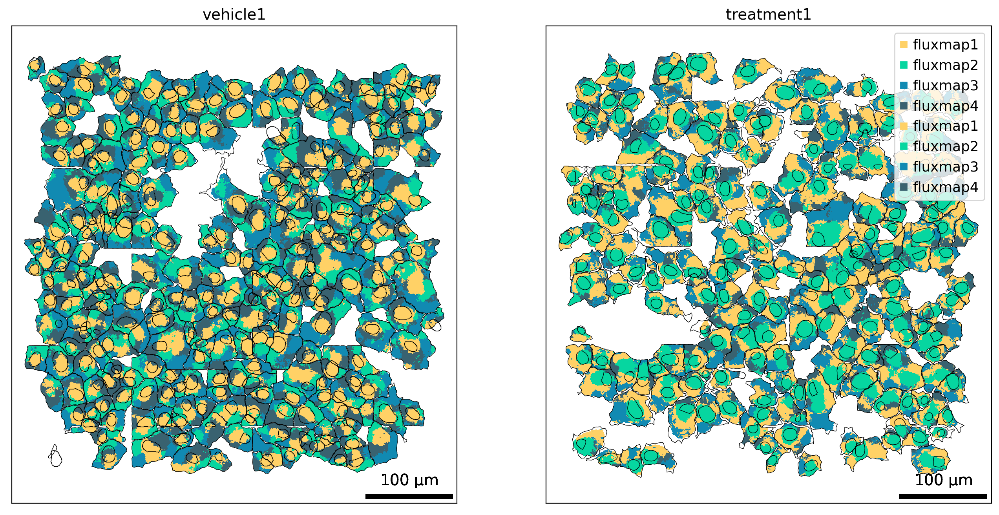

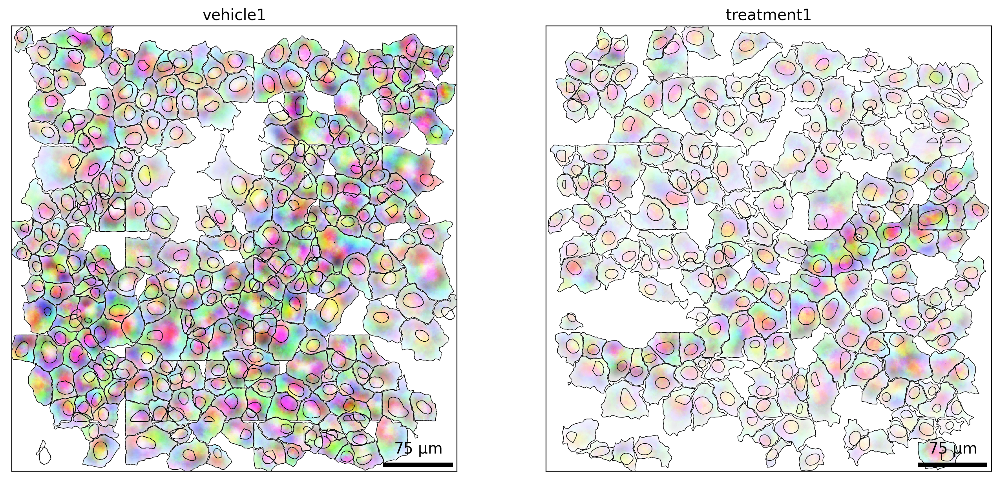

In [57]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.fluxmap(
        adata,
        palette=bento.colors.bento6,
        color_style="fill",
        dx=dx,
        lw=0,
        ax=ax,
        title=batch,
        square=True,
        # fname=f"/cellar/users/ckmah/spatial/figures/{batch}_flowmap.svg",
    )

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.flux(
        adata,
        res=0.2,
        dx=dx,
        ax=ax,
        title=batch,
        square=True,
        #     fname=f"/cellar/users/ckmah/spatial/figures/{batch}_flow.svg",
    )

---

# Domain enrichment

In [58]:
bento.tl.fe_fazal2019(adatas[0], batch_size=50000)
bento.tl.fe_fazal2019(adatas[1], batch_size=50000)

27 samples of mat are empty, they will be removed.
Running wsum on mat with 351422 samples and 96 targets for 8 sources.
Infering activities on 8 batches.


100%|██████████| 8/8 [01:05<00:00,  8.20s/it]


Running wsum on mat with 302727 samples and 92 targets for 8 sources.
Infering activities on 7 batches.


100%|██████████| 7/7 [00:54<00:00,  7.85s/it]


In [59]:
# for adata, batch in zip(adatas, batch_names):
#     bento.io.write_h5ad(adata, f"{folder}/{batch}_fluxmap.h5ad")

In [73]:
@bento.pl._utils.savefig
def plot_domain_fe(data, fname=None):
    domains = [
        "flux_Cytosol",
        "flux_Nucleus",
        "flux_ERM",
        "flux_Nucleolus",
        "flux_ER Lumen",
        "flux_OMM",
        "flux_Nuclear Pore",
        "flux_Lamina",
    ]

    domain_fe = pd.DataFrame(
        np.stack([data.uns[d] for d in domains], axis=1),
        index=data.uns["cell_raster"].index,
        columns=domains,
    )

    domain_fe = domain_fe.groupby(data.uns["cell_raster"]["fluxmap"]).mean()
    domain_fe.columns = [d.split("flux_")[1] for d in domain_fe.columns]

    # domain_fe = domain_fe.iloc[1:]

    with sns.axes_style("white"):
        g = sns.clustermap(
            domain_fe.T,
            center=0,
            cmap=bento.colors.red2blue,
            figsize=(4, 4.5),
        )
        g.ax_heatmap.spines[:].set_visible(True)

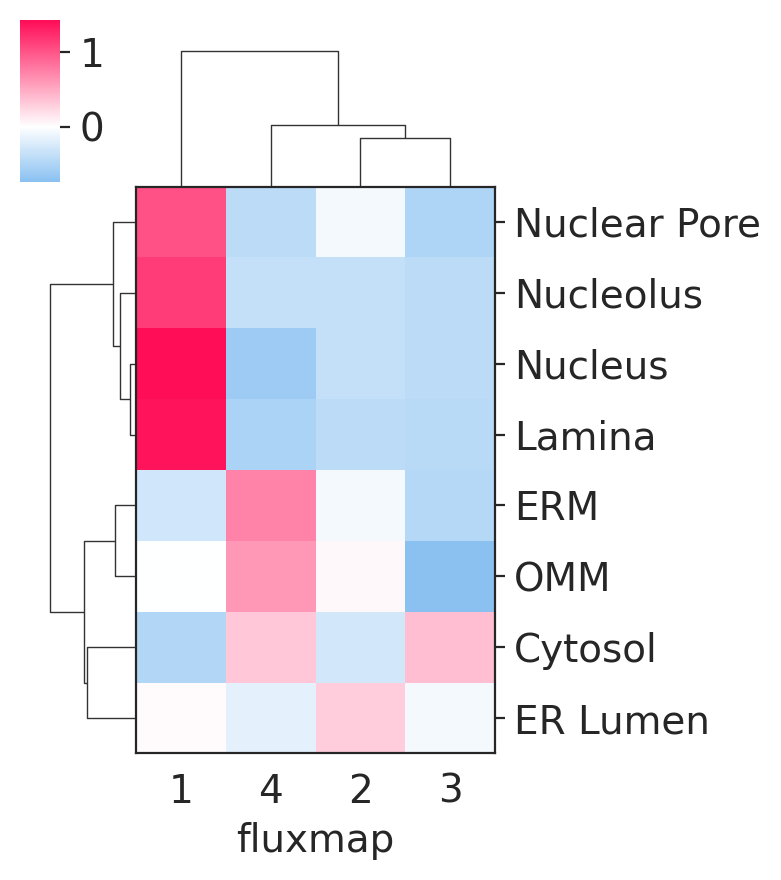

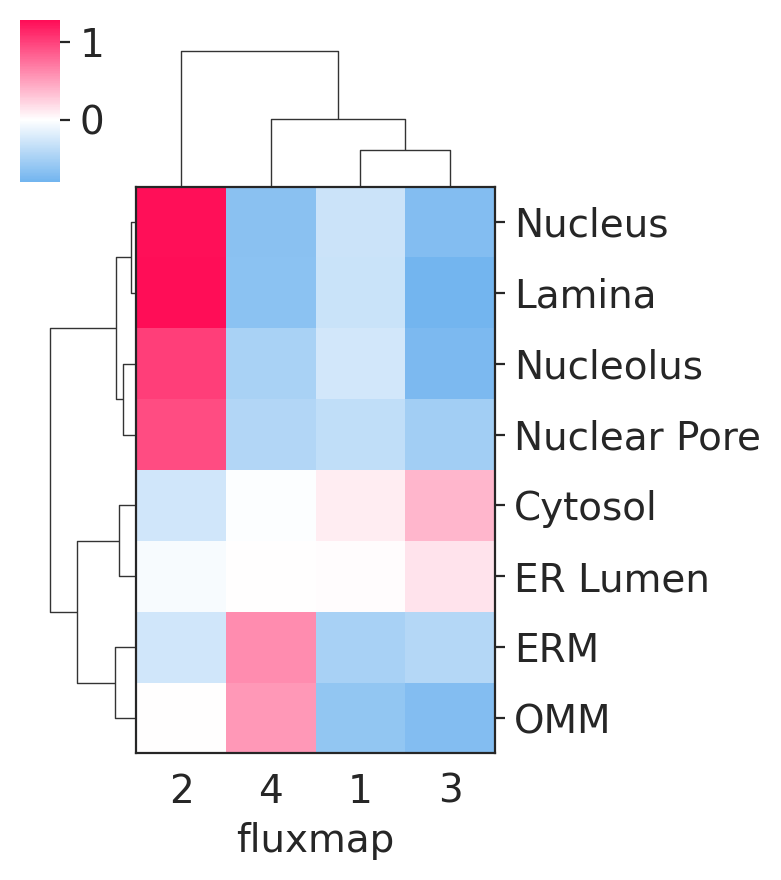

In [74]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    plot_domain_fe(
        adata,
    )

# Assign domain colors

In [100]:
# TODO map to nucleus, outside nucleus
flowmap_map = {
    "vehicle1": {
        "1": "1",
        "2": "3",
        "3": "4",
        "4": "2",
    },
    "treatment1": {
        "1": "4",
        "2": "1",
        "3": "3",
        "4": "2",
    },
}

pt_map = dict()
shape_map = dict()
for batch, mp in flowmap_map.items():
    pt_map[batch] = dict()
    shape_map[batch] = dict()
    for key, val in mp.items():
        pt_map[batch][f"fluxmap{key}"] = f"fluxmap{val}"
        shape_map[batch][f"fluxmap{key}_shape"] = f"fluxmap{val}_shape"

Remap domain numbers so matching domains are the same number

In [101]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    adata.uns["cell_raster"]["fluxmap"] = (
        adata.uns["cell_raster"]["fluxmap"].astype(str).map(flowmap_map[batch])
    )

    adata.uns["points"] = adata.uns["points"].rename(columns=pt_map[batch])
    adata.obs = adata.obs.rename(columns=shape_map[batch])

In [ ]:
# for adata, batch in zip(adatas, batch_names):
#     bento.io.write_h5ad(adata, f"{figdir}/{batch}_flowmap.h5ad")

Saved to /home/ckmah/d/bento-manuscript/figures/cardio_vehicle1_fe_heatmap.svg
Saved to /home/ckmah/d/bento-manuscript/figures/cardio_treatment1_fe_heatmap.svg


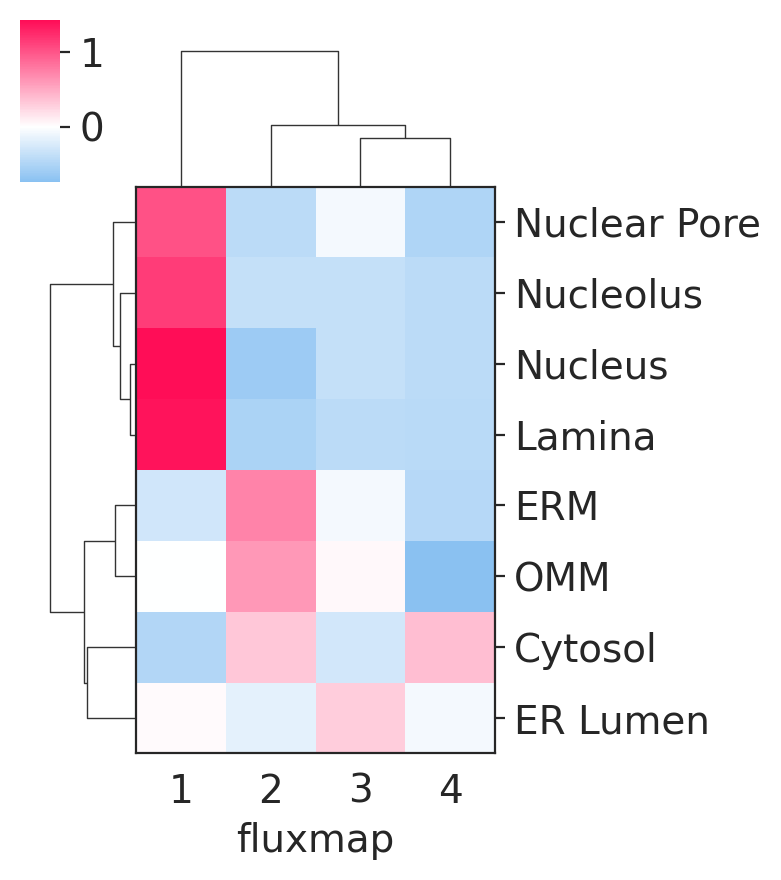

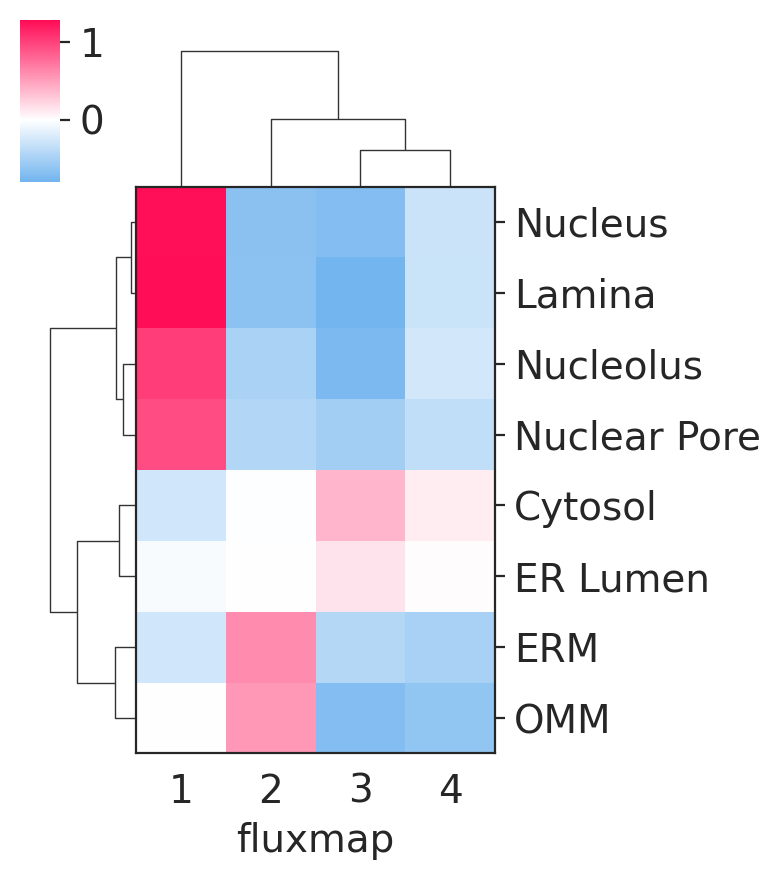

In [102]:
for adata, batch in zip(adatas[:2], batch_names[:2]):
    plot_domain_fe(
        adata,
        fname=f"{figdir}/cardio_{batch}_fe_heatmap.svg",
    )

In [103]:
domain_palette = {
    "fluxmap1": sns.desaturate("#ef476f", 0.85),
    "fluxmap2": sns.desaturate("#FFD166", 0.85),
    "fluxmap3": sns.desaturate("#118AB2", 0.85),
    "fluxmap4": sns.desaturate("#06D6A0", 0.85),
}

[14:30:54] WARNING  No handles with labels found to put in legend.                                   ]8;id=141297;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=54991;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Saved to /home/ckmah/d/bento-manuscript/figures/vehicle1_fluxmap.svg


[14:30:57] WARNING  No handles with labels found to put in legend.                                   ]8;id=652385;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=740287;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Saved to /home/ckmah/d/bento-manuscript/figures/treatment1_fluxmap.svg


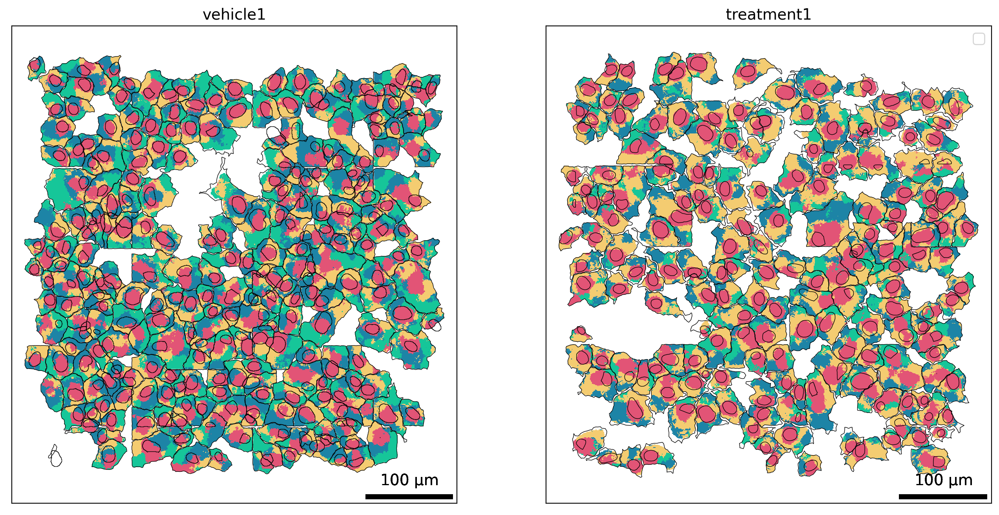

In [189]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.fluxmap(
        adata,
        palette=domain_palette,
        color_style="fill",
        dx=dx,
        lw=0,
        ax=ax,
        title=batch,
        square=True,
        fname=f"{figdir}/{batch}_fluxmap.svg",
    )

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
for adata, batch, ax in zip(adatas, batch_names, axes):
    bento.pl.flux(
        adata,
        res=0.2,
        dx=dx,
        ax=ax,
        alpha=False,
        title=batch,
        square=True,
        fname=f"{figdir}/{batch}_flow.svg",
    )

---

In [104]:
apex_gs = ["Nucleus", "OMM", "ER", "Cytosol"]
domains = ["1", "2", "3", "4"]

Saved to /home/ckmah/d/bento-manuscript/figures/cardio_vehicle1_fe.svg
Saved to /home/ckmah/d/bento-manuscript/figures/cardio_treatment1_fe.svg


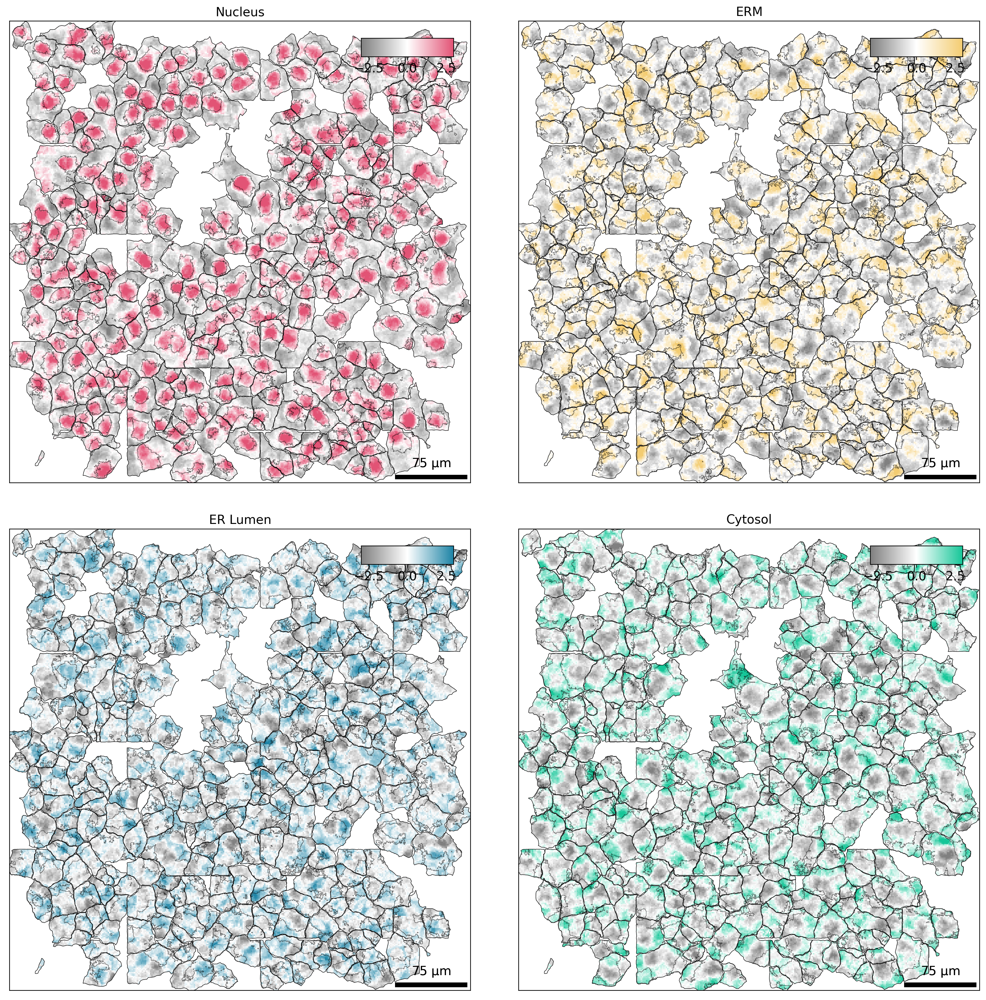

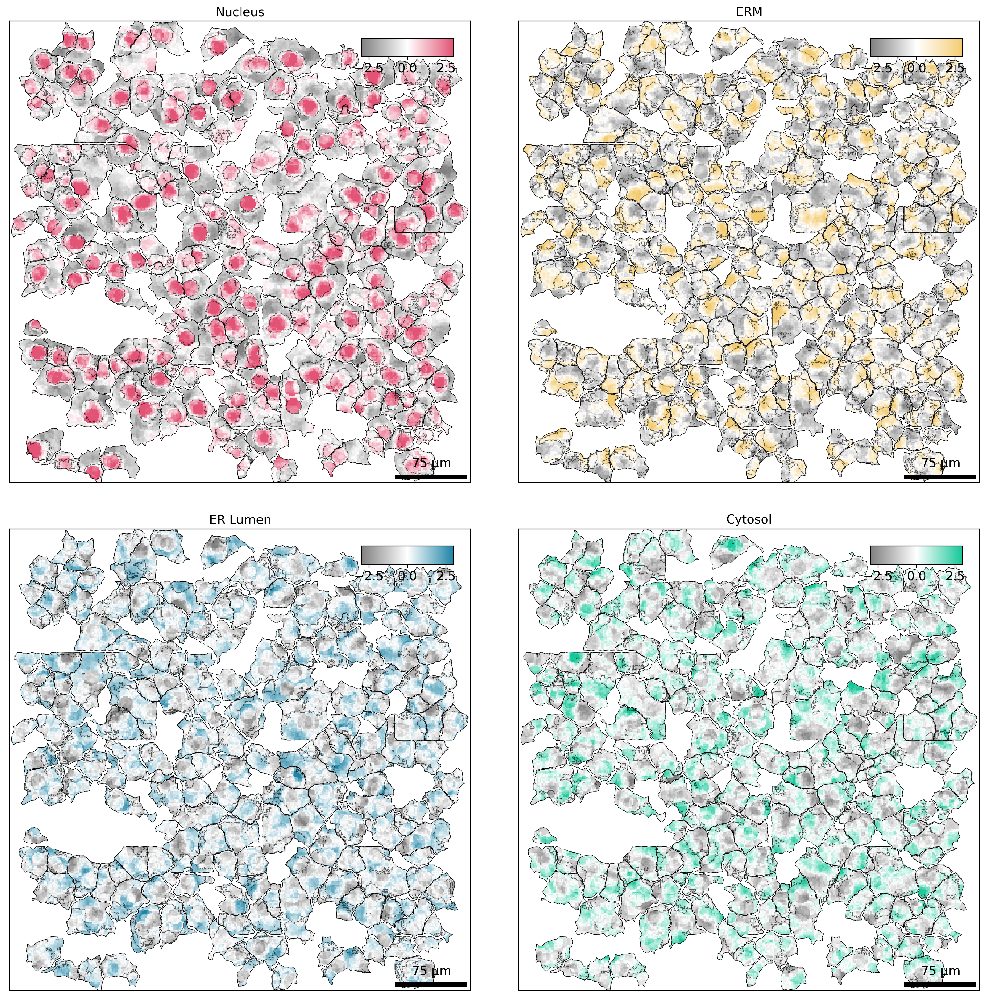

In [153]:
@bento.pl._utils.savefig
def plot_flux_fe(data, batch, fname=None):
    domains = [
        "flux_Cytosol",
        "flux_Nucleus",
        "flux_ERM",
        "flux_Nucleolus",
        "flux_ER Lumen",
        "flux_OMM",
        "flux_Nuclear Pore",
        "flux_Lamina",
    ]

    domain_fe = pd.DataFrame(
        np.stack([data.uns[d] for d in domains], axis=1),
        index=data.uns["cell_raster"].index,
        columns=domains,
    )

    domain_fe = domain_fe.groupby(data.uns["cell_raster"]["fluxmap"]).mean()

    fluxmap2domain = domain_fe.idxmax(axis=1)
    fig, axes = plt.subplots(2, 2, figsize=(20, 20))
    for shape, color, ax in zip(fluxmap2domain.index, bento.colors.bento6, axes.flat):
        cmap = mpl.colors.LinearSegmentedColormap.from_list(
            "_", ["gray", "white", domain_palette[f"fluxmap{shape}"]]
        )
        domain = fluxmap2domain[shape]
        bento.pl.shapes(
            adata,
            shapes=f"fluxmap{shape}",
            # lw=0.5,
            alpha=0.6,
            ax=ax,
            dx=dx,
        )
        bento.pl.fe(
            adata,
            domain,
            res=0.1,
            cmap=cmap,
            ax=ax,
            title=domain.split("_")[1],
            shapes=["cell_shape"],
            square=True,
            vmin=-3,
            vmax=3,
            dx=dx,
        )

    # remove empty axes
    for ax in axes.flat[domain_fe.shape[0] :]:
        ax.remove()
    plt.subplots_adjust(wspace=0.05, hspace=0.1)


for adata, batch in zip(adatas, batch_names):
    # with mpl.style.context("dark_background"):
    plot_flux_fe(
        adatas[0],
        batch,
        fname=f"{figdir}/cardio_{batch}_fe.svg",
    )

---

# Recombine for flow summary

In [116]:
adata_flux_diff = bento.io.concatenate(adatas[:2])

In [117]:
adata_flux_diff.uns["cell_raster"] = pd.concat(
    [adata.uns["cell_raster"] for adata in adatas[:2]], ignore_index=True
)

In [118]:
dims = adata_flux_diff.obs.columns[
    adata_flux_diff.obs.columns.str.startswith("fluxmap")
]

In [119]:
adata_flux_diff.obs["batch"] = adata_flux_diff.obs["batch"].replace(
    {"0": "vehicle1", "1": "treatment1"}
)

In [120]:
bento.tl.comp_diff(adata_flux_diff, dims, "batch", "vehicle1")
comp_diff = adata_flux_diff.uns["batch_comp_stats"]["treatment1"]

In [121]:
top_diff = (
    comp_diff.query("logcounts > 5")
    .query("cell_fraction > 20")
    .sort_values("treatment1_diff", ascending=False)
)

In [122]:
dims

Index(['fluxmap1_shape', 'fluxmap2_shape', 'fluxmap4_shape', 'fluxmap3_shape'], dtype='object')

[11:48:16] WARNING  No handles with labels found to put in legend.                                   ]8;id=268688;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=996511;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Adjusting text positions...


           WARNING  No handles with labels found to put in legend.                                   ]8;id=775534;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=728324;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Adjusting text positions...
Saved to /home/ckmah/d/bento-manuscript/figures/cardio_flux_summary.svg


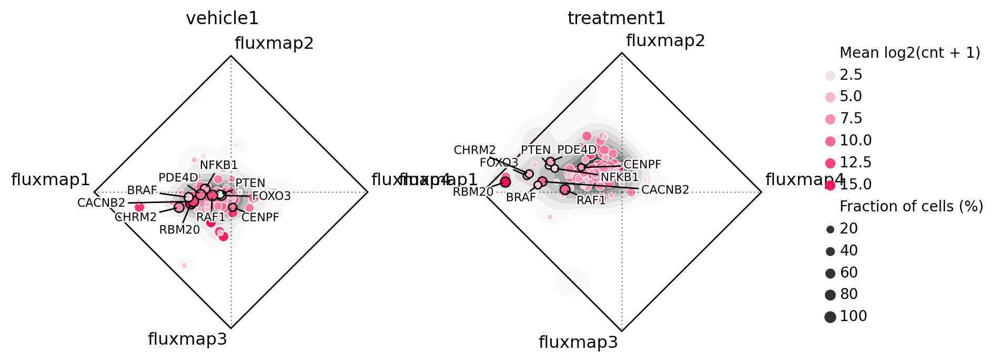

In [137]:
bento.pl.flux_summary(
    adata_flux_diff,
    annotate=top_diff.index[:10].tolist(),
    groupby="batch",
    group_order=["vehicle1", "treatment1"],
    dim_order=["fluxmap4", "fluxmap2", "fluxmap1", "fluxmap3"],
    sizes=(15, 50),
    height=4,
    fname=f"{figdir}/cardio_flux_summary.svg",
)

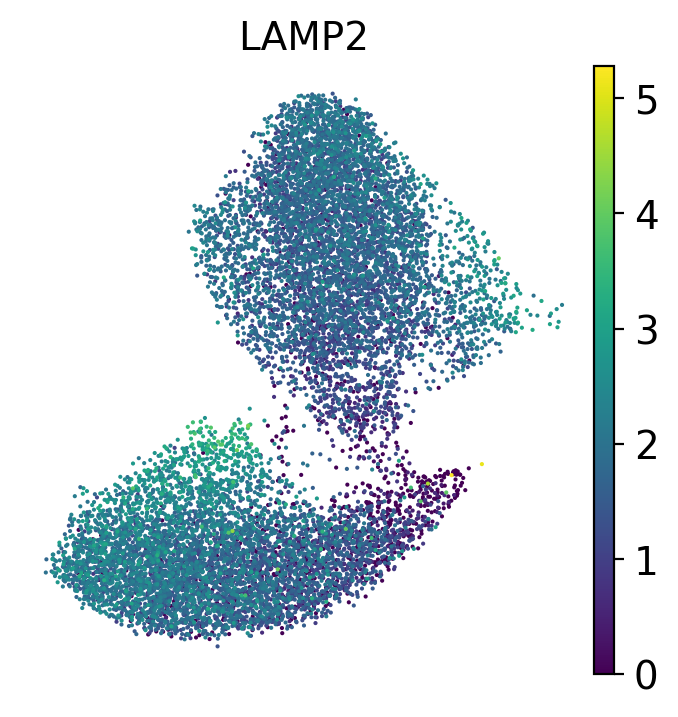

In [172]:
with plt.rc_context({"svg.fonttype": "none", "font.family": "Arial"}):
    sc.pl.umap(adata_diff, color="LAMP2", frameon=False, save="cardio_lamp2.svg")

[14:09:16] WARNING  No handles with labels found to put in legend.                                   ]8;id=881282;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=301743;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Adjusting text positions...


           WARNING  No handles with labels found to put in legend.                                   ]8;id=420379;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py\legend.py]8;;\:]8;id=978064;file:///home/ckmah/mambaforge/envs/bento-manuscript/lib/python3.9/site-packages/matplotlib/legend.py#1225\1225]8;;\

Adjusting text positions...
Saved to /home/ckmah/d/bento-manuscript/figures/cardio_summary_lamp2.svg


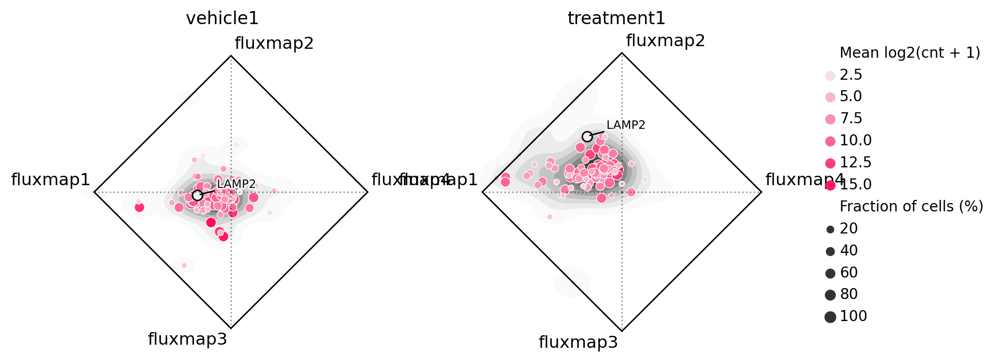

In [177]:
bento.pl.flux_summary(
    adata_flux_diff,
    annotate=["LAMP2"],
    groupby="batch",
    group_order=["vehicle1", "treatment1"],
    dim_order=["fluxmap4", "fluxmap2", "fluxmap1", "fluxmap3"],
    sizes=(15, 50),
    height=4,
    fname=f"{figdir}/cardio_summary_lamp2.svg",
)

In [185]:
@bento.pl._utils.savefig
def plot_gene(gene, domain, fname=None):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    for adata, ax in zip(adatas, axes):
        bento.pl.points(
            adata[:, gene], c="black", shapes=["cell"], zorder=100, dx=dx, ax=ax
        )
        bento.pl.shapes(
            adata,
            shapes=[domain],
            color_style="outline",
            color=domain_palette[domain],
            dx=dx,
            ax=ax,
        )
        bento.pl.shapes(
            adata,
            shapes=[domain],
            color_style="fill",
            color=domain_palette[domain],
            alpha=0.4,
            dx=dx,
            ax=ax,
        )

In [126]:
vehicle_ranks = sc.get.rank_genes_groups_df(adata_diff, "vehicle")
vehicle_ranks["abs_scores"] = vehicle_ranks["scores"].abs()
vehicle_ranks = vehicle_ranks.sort_values("abs_scores", ascending=True)
vehicle_ranks.query("names == 'LAMP2'")

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,abs_scores
88,LAMP2,-13.901664,-0.264418,6.188615e-44,1.085722e-43,0.932812,0.911022,13.901664


In [127]:
vt_diff = (
    adata_flux_diff.uns["batch_comp_stats"]["vehicle1"][
        [f"fluxmap{d}" for d in [1, 2, 3, 4]]
    ]
    - adata_flux_diff.uns["batch_comp_stats"]["treatment1"][
        [f"fluxmap{d}" for d in [1, 2, 3, 4]]
    ]
)
vt_diff = vt_diff.fillna(0)

In [128]:
vehicle_ranks.set_index("names")["logfoldchanges"]

names
IL2       -0.597901
CALCA      1.093170
CCN2       0.277511
CACNA1E    0.380202
NOS2      -0.029437
             ...   
SMAD7      3.690174
PIK3R1     2.835541
NEAT1      2.704294
CACNB2     2.182589
LRRC10     4.118883
Name: logfoldchanges, Length: 100, dtype: float32

In [129]:
from scipy.stats import spearmanr

In [130]:
spearmanr(
    vehicle_ranks.set_index("names").loc[vt_diff.index, "logfoldchanges"],
    vt_diff["fluxmap3"],
)

SignificanceResult(statistic=0.07057770186742728, pvalue=0.49440989938319035)

In [131]:
vt_diff

,fluxmap1,fluxmap2,fluxmap3,fluxmap4
gene,,,,
ABCC9,0.032850,-0.119565,0.055556,-0.002657
ACTN2,-0.036818,-0.112786,0.059601,0.084883
ADM,0.014410,-0.275464,0.135629,0.106718
ADRB1,-0.145833,0.322917,-0.088542,0.182292
AGT,-0.054528,-0.016385,0.082372,0.014823
...,...,...,...,...
TGFB3,-0.103928,-0.082338,0.090329,0.100742
TMPO,-0.247970,0.027204,0.088132,0.131442
TTR,-0.243590,0.077991,0.068376,0.097222


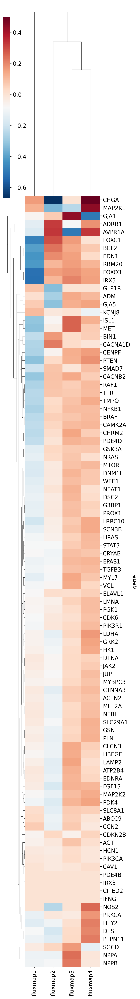

In [132]:
sns.clustermap(vt_diff, cmap="RdBu_r", figsize=(5, 35))

Saved to /home/ckmah/d/bento-manuscript/figures/cardio_lamp2.svg


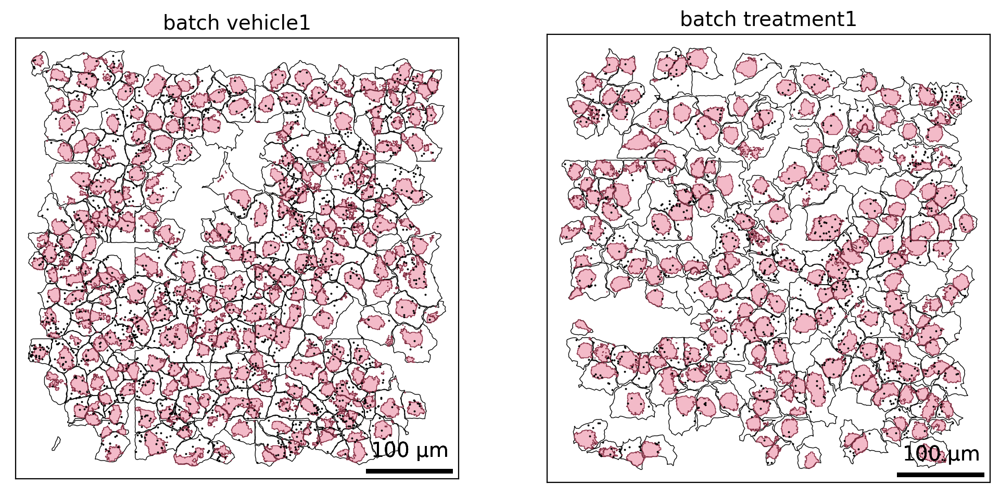

In [186]:
plot_gene("LAMP2", "fluxmap1", fname=f"{figdir}/cardio_lamp2.svg")

Saved to /home/ckmah/d/bento-manuscript/figures/cardio_rbm20.svg


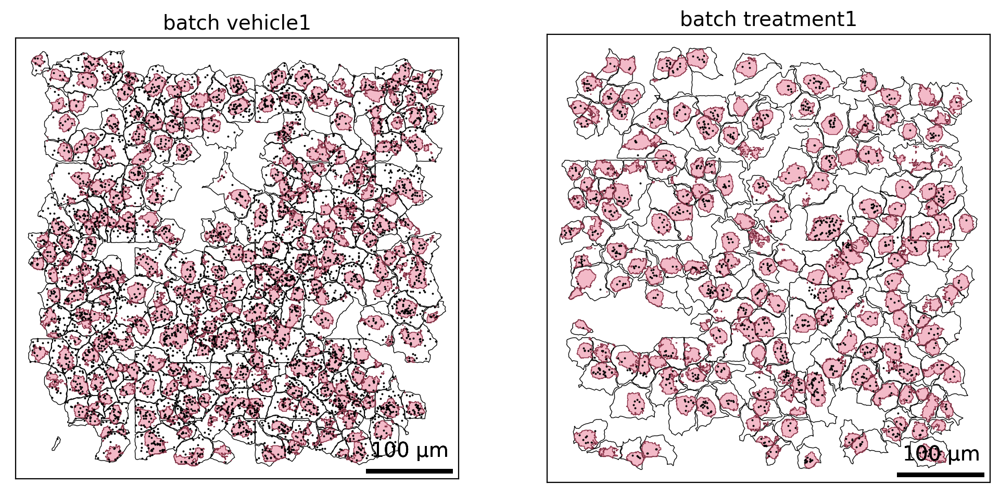

In [187]:
plot_gene("RBM20", "fluxmap1", fname=f"{figdir}/cardio_rbm20.svg")

Saved to /home/ckmah/d/bento-manuscript/figures/cardio_cacnb2.svg


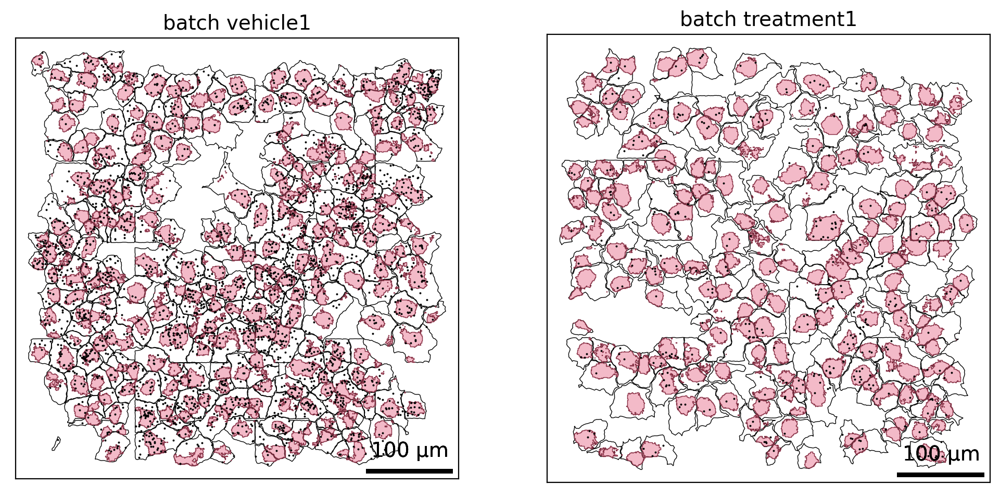

In [188]:
plot_gene("CACNB2", "fluxmap1", fname=f"{figdir}/cardio_cacnb2.svg")

In [ ]:
bento.io.write_h5ad(adatas[0], "cardio_vehicle1.h5ad")
bento.io.write_h5ad(adatas[1], "cardio_treatment1.h5ad")

... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
... storing 'fluxmap1_shape' as categorical
... storing 'fluxmap4_shape' as categorical
... storing 'fluxmap3_shape' as categorical
... storing 'nucleus_shape' as categorical
... storing 'batch' as categorical
